In [57]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os, sys, glob
import cartopy.crs as ccrs # use cartopy for maps
import matplotlib.path as mpath
import datetime as dt
import cartopy.feature as cfeature # for coastlines

In [58]:
# scenario ssp2-45

ssp245_ar_25_34 = xr.open_dataset(r"data\arctic\ssp245\CM61-LR-scen-ssp245_20250101_20341231_1M_histmth_arctic_CLEANED.nc",  engine="h5netcdf")
ssp245_ar_55_64 = xr.open_dataset(r"data\arctic\ssp245\CM61-LR-scen-ssp245_20550101_20641231_1M_histmth_arctic_CLEANED.nc",  engine="h5netcdf")
ssp245_ar_85_94 = xr.open_dataset(r"data\arctic\ssp245\CM61-LR-scen-ssp245_20850101_20941231_1M_histmth_arctic_CLEANED.nc",  engine="h5netcdf")

ssp245_eu_25_34 = xr.open_dataset(r"data\europe\ssp245\CM61-LR-scen-ssp245_20250101_20341231_1M_histmth_europe_CLEANED.nc",  engine="h5netcdf")
ssp245_eu_55_64 = xr.open_dataset(r"data\europe\ssp245\CM61-LR-scen-ssp245_20550101_20641231_1M_histmth_europe_CLEANED.nc",  engine="h5netcdf")
ssp245_eu_85_94 = xr.open_dataset(r"data\europe\ssp245\CM61-LR-scen-ssp245_20850101_20941231_1M_histmth_europe_CLEANED.nc",  engine="h5netcdf")

# FIX: apply rename + datetime conversion directly
def fix_time(ds):
    ds = ds.rename({'time_counter': 'time'})
    ds = ds.assign_coords(time=pd.to_datetime(ds['time'].values))
    return ds

ssp245_ar_25_34 = fix_time(ssp245_ar_25_34)
ssp245_ar_55_64 = fix_time(ssp245_ar_55_64)     
ssp245_ar_85_94 = fix_time(ssp245_ar_85_94)

ssp245_eu_25_34 = fix_time(ssp245_eu_25_34)
ssp245_eu_55_64 = fix_time(ssp245_eu_55_64)     
ssp245_eu_85_94 = fix_time(ssp245_eu_85_94)


In [59]:
# scenario ssp2-85

ssp585_ar_25_34 = xr.open_dataset(r"data\arctic\ssp585\CM61-LR-scen-ssp585_20250101_20341231_1M_histmth_arctic_CLEANED.nc",  engine="h5netcdf")
ssp585_ar_55_64 = xr.open_dataset(r"data\arctic\ssp585\CM61-LR-scen-ssp585_20550101_20641231_1M_histmth_arctic_CLEANED.nc",  engine="h5netcdf")
ssp585_ar_85_94 = xr.open_dataset(r"data\arctic\ssp585\CM61-LR-scen-ssp585_20850101_20941231_1M_histmth_arctic_CLEANED.nc",  engine="h5netcdf")

ssp585_eu_25_34 = xr.open_dataset(r"data\europe\ssp585\CM61-LR-scen-ssp585_20250101_20341231_1M_histmth_europe_CLEANED.nc",  engine="h5netcdf")
ssp585_eu_55_64 = xr.open_dataset(r"data\europe\ssp585\CM61-LR-scen-ssp585_20550101_20641231_1M_histmth_europe_CLEANED.nc",  engine="h5netcdf")
ssp585_eu_85_94 = xr.open_dataset(r"data\europe\ssp585\CM61-LR-scen-ssp585_20850101_20941231_1M_histmth_europe_CLEANED.nc",  engine="h5netcdf")
# FIX: apply rename + datetime conversion directly
def fix_time(ds):
    ds = ds.rename({'time_counter': 'time'})
    ds = ds.assign_coords(time=pd.to_datetime(ds['time'].values))
    return ds

ssp585_ar_25_34 = fix_time(ssp585_ar_25_34)
ssp585_ar_55_64 = fix_time(ssp585_ar_55_64)     
ssp585_ar_85_94 = fix_time(ssp585_ar_85_94)

ssp585_eu_25_34 = fix_time(ssp585_eu_25_34)
ssp585_eu_55_64 = fix_time(ssp585_eu_55_64)     
ssp585_eu_85_94 = fix_time(ssp585_eu_85_94)

In [60]:
ssp245_ar_25_34

<xarray.Dataset> Size: 4MB
Dimensions:        (time: 120, lat: 27, lon: 144)
Coordinates:
  * time           (time) datetime64[ns] 960B 2025-01-16T12:00:00 ... 2034-12...
  * lat            (lat) float32 108B 90.0 88.73 87.46 ... 59.58 58.31 57.04
  * lon            (lon) float32 576B -180.0 -177.5 -175.0 ... 172.5 175.0 177.5
    time_instant   (time) datetime64[ns] 960B ...
    time_centered  (time) datetime64[ns] 960B ...
Data variables:
    t2m            (time, lat, lon) float32 2MB ...
    sicf           (time, lat, lon) float32 2MB ...
Attributes:
    name:                      histmth
    description:               Created by xios
    title:                     Created by xios
    Conventions:               CF-1.6
    timeStamp:                 2018-Dec-06 07:53:05 GMT
    uuid:                      ed30e218-6892-487a-90db-c6942fb038bf
    LongName:                  IPSLCM6.1.8-LR
    history:                   Fri Dec  7 02:43:11 2018: ncrcat -C --buffer_s...
    NCO:                       "4.6.0"
    nco_openmp_thread_number:  1

In [61]:
ssp585_ar_25_34

<xarray.Dataset> Size: 4MB
Dimensions:        (time: 120, lat: 27, lon: 144)
Coordinates:
  * time           (time) datetime64[ns] 960B 2025-01-16T12:00:00 ... 2034-12...
  * lat            (lat) float32 108B 90.0 88.73 87.46 ... 59.58 58.31 57.04
  * lon            (lon) float32 576B -180.0 -177.5 -175.0 ... 172.5 175.0 177.5
    time_instant   (time) datetime64[ns] 960B ...
    time_centered  (time) datetime64[ns] 960B ...
Data variables:
    t2m            (time, lat, lon) float32 2MB ...
    sicf           (time, lat, lon) float32 2MB ...
Attributes:
    name:                      histmth
    description:               Created by xios
    title:                     Created by xios
    Conventions:               CF-1.6
    timeStamp:                 2018-Dec-19 15:24:20 GMT
    uuid:                      134e918a-ee2e-4183-92bd-7de0c6144b1f
    LongName:                  IPSLCM6.1.8-LR
    history:                   Thu Dec 20 07:22:53 2018: ncrcat -C --buffer_s...
    NCO:                       "4.6.0"
    nco_openmp_thread_number:  1

### Global analysis

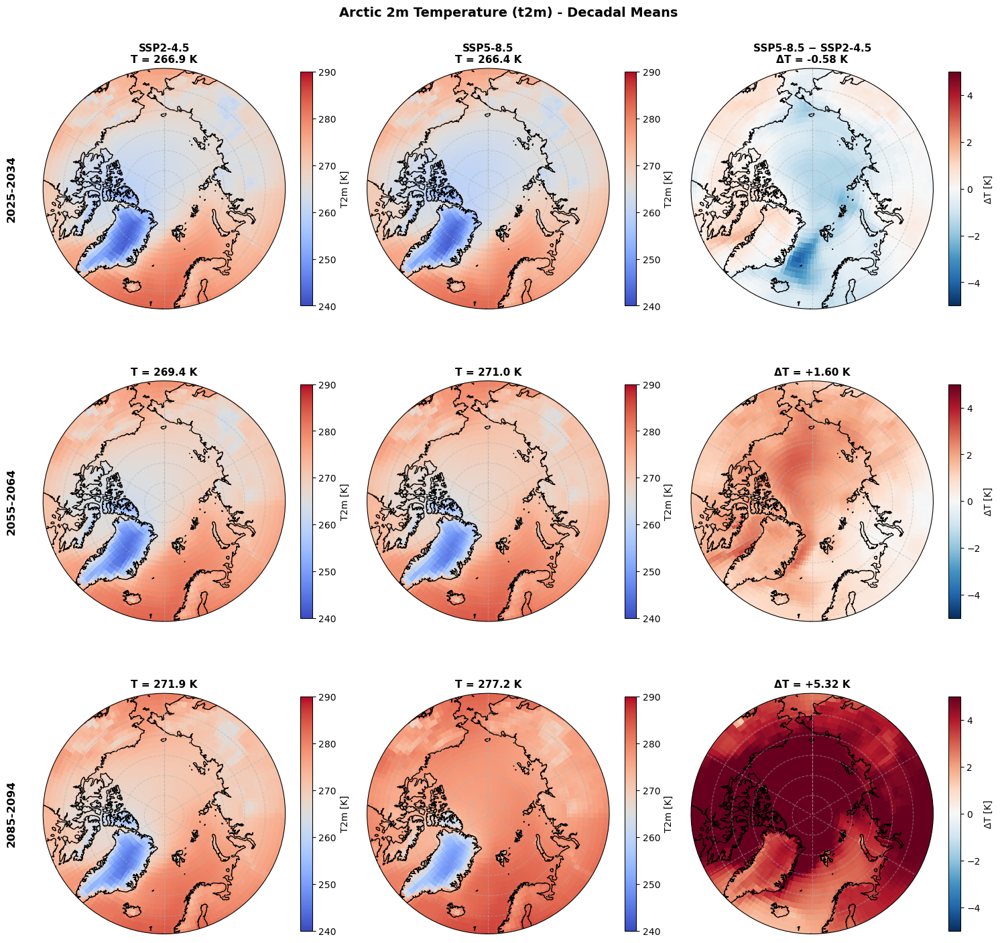

In [ ]:
# ============================================================
# ARCTIC FIGURE (3x3): North Polar Stereographic with circular boundary
# ============================================================

# Compute decadal means for t2m
ssp245_ar_25_mean = ssp245_ar_25_34['t2m'].mean(dim='time')
ssp245_ar_55_mean = ssp245_ar_55_64['t2m'].mean(dim='time')
ssp245_ar_85_mean = ssp245_ar_85_94['t2m'].mean(dim='time')

ssp585_ar_25_mean = ssp585_ar_25_34['t2m'].mean(dim='time')
ssp585_ar_55_mean = ssp585_ar_55_64['t2m'].mean(dim='time')
ssp585_ar_85_mean = ssp585_ar_85_94['t2m'].mean(dim='time')

# Differences
diff_ar_25 = ssp585_ar_25_mean - ssp245_ar_25_mean
diff_ar_55 = ssp585_ar_55_mean - ssp245_ar_55_mean
diff_ar_85 = ssp585_ar_85_mean - ssp245_ar_85_mean

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_ar, axes_ar = plt.subplots(3, 3, figsize=(15, 15),
                                subplot_kw={'projection': ccrs.NorthPolarStereo()})

# Data layout: rows = decades, cols = [SSP245, SSP585, Difference]
arctic_data = [
    [ssp245_ar_25_mean, ssp585_ar_25_mean, diff_ar_25],
    [ssp245_ar_55_mean, ssp585_ar_55_mean, diff_ar_55],
    [ssp245_ar_85_mean, ssp585_ar_85_mean, diff_ar_85],
]
row_labels = ['2025-2034', '2055-2064', '2085-2094']
col_labels = ['SSP2-4.5', 'SSP5-8.5', 'SSP5-8.5 − SSP2-4.5']

for i, row in enumerate(arctic_data):
    for j, data in enumerate(row):
        ax = axes_ar[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        # Compute spatial mean for title
        spatial_mean = float(data.mean())
        
        # Use different colormap for difference
        if j == 2:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu_r', vmin=-5, vmax=5)
            cbar_label = 'ΔT [K]'
            mean_text = f'ΔT = {spatial_mean:+.2f} K'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='coolwarm', vmin=240, vmax=290)
            cbar_label = 'T2m [K]'
            mean_text = f'T = {spatial_mean:.1f} K'
        
        ax.coastlines()
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        # Column label only on first row, mean on all subplots
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        if j == 0:
            ax.text(-0.15, 0.5, row_labels[i], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_ar.suptitle('Arctic 2m Temperature (t2m) - Decadal Means', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_t2m_comparison.png', dpi=150, bbox_inches='tight')
plt.show()

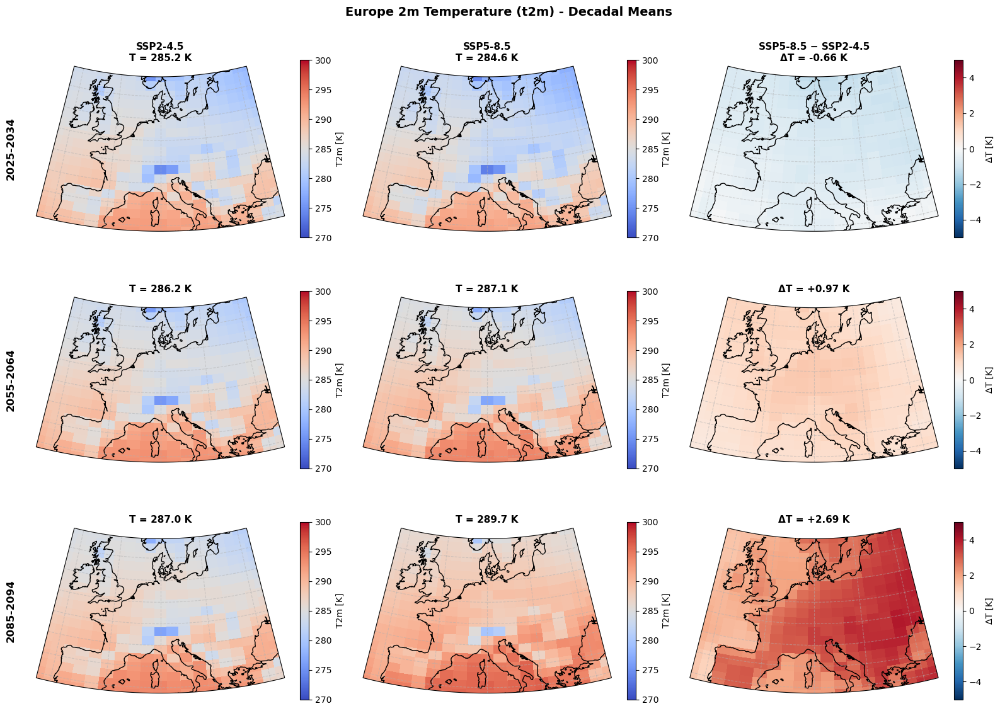

In [ ]:
# ============================================================
# EUROPE FIGURE (3x3): with data-edge boundary
# ============================================================

ssp245_eu_25_mean = ssp245_eu_25_34['t2m'].mean(dim='time')
ssp245_eu_55_mean = ssp245_eu_55_64['t2m'].mean(dim='time')
ssp245_eu_85_mean = ssp245_eu_85_94['t2m'].mean(dim='time')

ssp585_eu_25_mean = ssp585_eu_25_34['t2m'].mean(dim='time')
ssp585_eu_55_mean = ssp585_eu_55_64['t2m'].mean(dim='time')
ssp585_eu_85_mean = ssp585_eu_85_94['t2m'].mean(dim='time')

diff_eu_25 = ssp585_eu_25_mean - ssp245_eu_25_mean
diff_eu_55 = ssp585_eu_55_mean - ssp245_eu_55_mean
diff_eu_85 = ssp585_eu_85_mean - ssp245_eu_85_mean

# Get data bounds
lon_min = float(ssp245_eu_25_mean.lon.min())
lon_max = float(ssp245_eu_25_mean.lon.max())
lat_min = float(ssp245_eu_25_mean.lat.min())
lat_max = float(ssp245_eu_25_mean.lat.max())

# Create boundary path from data edges (in projection coordinates)
proj = ccrs.LambertConformal(central_longitude=(lon_min+lon_max)/2)

# Build polygon vertices around data boundary
n_points = 50
bottom = np.column_stack([np.linspace(lon_min, lon_max, n_points), np.full(n_points, lat_min)])
right = np.column_stack([np.full(n_points, lon_max), np.linspace(lat_min, lat_max, n_points)])
top = np.column_stack([np.linspace(lon_max, lon_min, n_points), np.full(n_points, lat_max)])
left = np.column_stack([np.full(n_points, lon_min), np.linspace(lat_max, lat_min, n_points)])

boundary_lonlat = np.vstack([bottom, right, top, left])

# Transform to projection coordinates
boundary_proj = proj.transform_points(ccrs.PlateCarree(), boundary_lonlat[:, 0], boundary_lonlat[:, 1])
boundary_proj = boundary_proj[:, :2]  # drop z

# Normalize to [0, 1] range for ax.transAxes
x_min, x_max = boundary_proj[:, 0].min(), boundary_proj[:, 0].max()
y_min, y_max = boundary_proj[:, 1].min(), boundary_proj[:, 1].max()
boundary_norm = np.column_stack([
    (boundary_proj[:, 0] - x_min) / (x_max - x_min),
    (boundary_proj[:, 1] - y_min) / (y_max - y_min)
])

data_boundary = mpath.Path(boundary_norm)

fig_eu, axes_eu = plt.subplots(3, 3, figsize=(16, 12),
                                subplot_kw={'projection': proj})

europe_data = [
    [ssp245_eu_25_mean, ssp585_eu_25_mean, diff_eu_25],
    [ssp245_eu_55_mean, ssp585_eu_55_mean, diff_eu_55],
    [ssp245_eu_85_mean, ssp585_eu_85_mean, diff_eu_85],
]
row_labels = ['2025-2034', '2055-2064', '2085-2094']
col_labels = ['SSP2-4.5', 'SSP5-8.5', 'SSP5-8.5 − SSP2-4.5']

for i, row in enumerate(europe_data):
    for j, data in enumerate(row):
        ax = axes_eu[i, j]
        ax.set_extent([lon_min, lon_max, lat_min, lat_max], ccrs.PlateCarree())
        ax.set_boundary(data_boundary, transform=ax.transAxes)
        
        # Compute spatial mean for title
        spatial_mean = float(data.mean())
        
        if j == 2:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu_r', vmin=-5, vmax=5)
            cbar_label = 'ΔT [K]'
            mean_text = f'ΔT = {spatial_mean:+.2f} K'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='coolwarm', vmin=270, vmax=300)
            cbar_label = 'T2m [K]'
            mean_text = f'T = {spatial_mean:.1f} K'
        
        ax.coastlines()
        ax.gridlines(draw_labels=False, linestyle='--', alpha=0.5)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        # Column label only on first row, mean on all subplots
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        if j == 0:
            ax.text(-0.12, 0.5, row_labels[i], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_eu.suptitle('Europe 2m Temperature (t2m) - Decadal Means', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/europe_t2m_comparison.png', dpi=150, bbox_inches='tight')
plt.show()

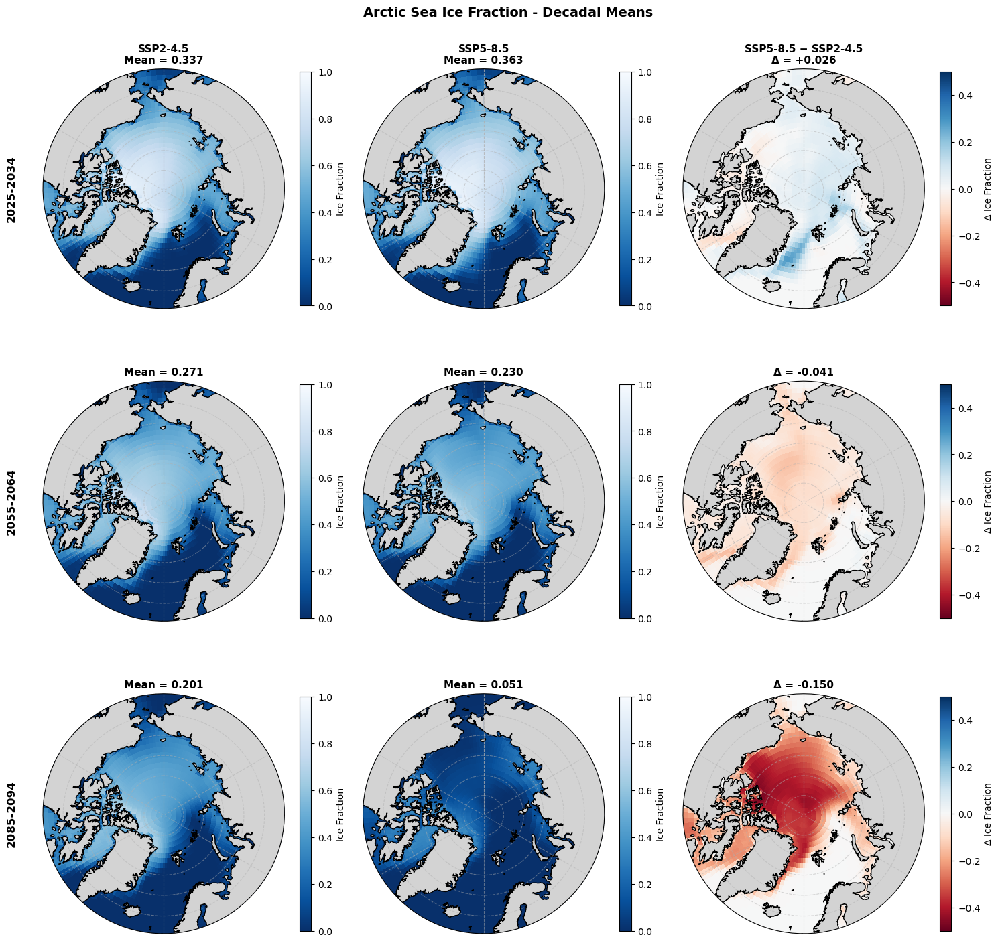

In [ ]:
# ============================================================
# ARCTIC FIGURE (3x3): Sea Ice Fraction - North Polar Stereographic
# ============================================================

ice_var = 'sicf'

ssp245_ar_25_ice = ssp245_ar_25_34[ice_var].mean(dim='time')
ssp245_ar_55_ice = ssp245_ar_55_64[ice_var].mean(dim='time')
ssp245_ar_85_ice = ssp245_ar_85_94[ice_var].mean(dim='time')

ssp585_ar_25_ice = ssp585_ar_25_34[ice_var].mean(dim='time')
ssp585_ar_55_ice = ssp585_ar_55_64[ice_var].mean(dim='time')
ssp585_ar_85_ice = ssp585_ar_85_94[ice_var].mean(dim='time')

# Differences
diff_ar_25_ice = ssp585_ar_25_ice - ssp245_ar_25_ice
diff_ar_55_ice = ssp585_ar_55_ice - ssp245_ar_55_ice
diff_ar_85_ice = ssp585_ar_85_ice - ssp245_ar_85_ice

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_ar_ice, axes_ar_ice = plt.subplots(3, 3, figsize=(15, 15),
                                        subplot_kw={'projection': ccrs.NorthPolarStereo()})

arctic_ice_data = [
    [ssp245_ar_25_ice, ssp585_ar_25_ice, diff_ar_25_ice],
    [ssp245_ar_55_ice, ssp585_ar_55_ice, diff_ar_55_ice],
    [ssp245_ar_85_ice, ssp585_ar_85_ice, diff_ar_85_ice],
]
row_labels = ['2025-2034', '2055-2064', '2085-2094']
col_labels = ['SSP2-4.5', 'SSP5-8.5', 'SSP5-8.5 − SSP2-4.5']

for i, row in enumerate(arctic_ice_data):
    for j, data in enumerate(row):
        ax = axes_ar_ice[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        # Compute spatial mean for title
        spatial_mean = float(data.mean())
        
        if j == 2:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu', vmin=-0.5, vmax=0.5)
            cbar_label = 'Δ Ice Fraction'
            mean_text = f'Δ = {spatial_mean:+.3f}'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='Blues_r', vmin=0, vmax=1)
            cbar_label = 'Ice Fraction'
            mean_text = f'Mean = {spatial_mean:.3f}'
        
        ax.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
        ax.coastlines(zorder=3)
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        # Column label only on first row, mean on all subplots
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        if j == 0:
            ax.text(-0.15, 0.5, row_labels[i], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_ar_ice.suptitle('Arctic Sea Ice Fraction - Decadal Means', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_seaice_comparison.png', dpi=150, bbox_inches='tight')
plt.show()

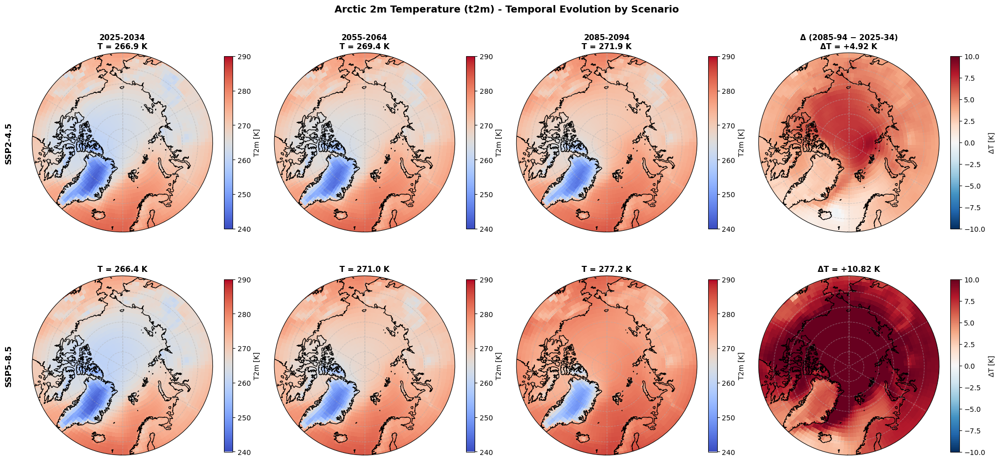

In [ ]:
# ============================================================
# ARCTIC T2M (2x4): Rows = scenarios, Cols = decades + temporal difference
# ============================================================

# Compute decadal means for t2m
ssp245_ar_25_mean = ssp245_ar_25_34['t2m'].mean(dim='time')
ssp245_ar_55_mean = ssp245_ar_55_64['t2m'].mean(dim='time')
ssp245_ar_85_mean = ssp245_ar_85_94['t2m'].mean(dim='time')

ssp585_ar_25_mean = ssp585_ar_25_34['t2m'].mean(dim='time')
ssp585_ar_55_mean = ssp585_ar_55_64['t2m'].mean(dim='time')
ssp585_ar_85_mean = ssp585_ar_85_94['t2m'].mean(dim='time')

# Temporal differences (2085-2094 minus 2025-2034) for each scenario
diff_ar_245_temporal = ssp245_ar_85_mean - ssp245_ar_25_mean
diff_ar_585_temporal = ssp585_ar_85_mean - ssp585_ar_25_mean

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_ar, axes_ar = plt.subplots(2, 4, figsize=(20, 10),
                                subplot_kw={'projection': ccrs.NorthPolarStereo()})

# Data layout: rows = scenarios, cols = [2025-34, 2055-64, 2085-94, Δ(2085-2025)]
arctic_data = [
    [ssp245_ar_25_mean, ssp245_ar_55_mean, ssp245_ar_85_mean, diff_ar_245_temporal],
    [ssp585_ar_25_mean, ssp585_ar_55_mean, ssp585_ar_85_mean, diff_ar_585_temporal],
]
row_labels = ['SSP2-4.5', 'SSP5-8.5']
col_labels = ['2025-2034', '2055-2064', '2085-2094', 'Δ (2085-94 − 2025-34)']

for i, row in enumerate(arctic_data):
    for j, data in enumerate(row):
        ax = axes_ar[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        spatial_mean = float(data.mean())
        
        if j == 3:  # Temporal difference column
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu_r', vmin=-10, vmax=10)
            cbar_label = 'ΔT [K]'
            mean_text = f'ΔT = {spatial_mean:+.2f} K'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='coolwarm', vmin=240, vmax=290)
            cbar_label = 'T2m [K]'
            mean_text = f'T = {spatial_mean:.1f} K'
        
        ax.coastlines()
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        if j == 0:
            ax.text(-0.15, 0.5, row_labels[i], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_ar.suptitle('Arctic 2m Temperature (t2m) - Temporal Evolution by Scenario', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_t2m_temporal_evolution.png', dpi=150, bbox_inches='tight')
plt.show()

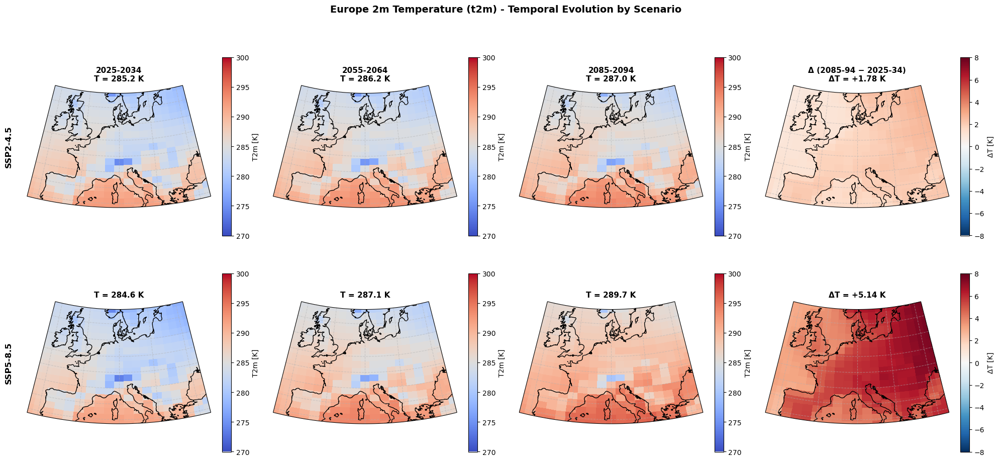

In [ ]:
# ============================================================
# EUROPE T2M (2x4): Rows = scenarios, Cols = decades + temporal difference
# ============================================================

ssp245_eu_25_mean = ssp245_eu_25_34['t2m'].mean(dim='time')
ssp245_eu_55_mean = ssp245_eu_55_64['t2m'].mean(dim='time')
ssp245_eu_85_mean = ssp245_eu_85_94['t2m'].mean(dim='time')

ssp585_eu_25_mean = ssp585_eu_25_34['t2m'].mean(dim='time')
ssp585_eu_55_mean = ssp585_eu_55_64['t2m'].mean(dim='time')
ssp585_eu_85_mean = ssp585_eu_85_94['t2m'].mean(dim='time')

# Temporal differences
diff_eu_245_temporal = ssp245_eu_85_mean - ssp245_eu_25_mean
diff_eu_585_temporal = ssp585_eu_85_mean - ssp585_eu_25_mean

# Get data bounds
lon_min = float(ssp245_eu_25_mean.lon.min())
lon_max = float(ssp245_eu_25_mean.lon.max())
lat_min = float(ssp245_eu_25_mean.lat.min())
lat_max = float(ssp245_eu_25_mean.lat.max())

# Create boundary path
proj = ccrs.LambertConformal(central_longitude=(lon_min+lon_max)/2)
n_points = 50
bottom = np.column_stack([np.linspace(lon_min, lon_max, n_points), np.full(n_points, lat_min)])
right = np.column_stack([np.full(n_points, lon_max), np.linspace(lat_min, lat_max, n_points)])
top = np.column_stack([np.linspace(lon_max, lon_min, n_points), np.full(n_points, lat_max)])
left = np.column_stack([np.full(n_points, lon_min), np.linspace(lat_max, lat_min, n_points)])
boundary_lonlat = np.vstack([bottom, right, top, left])
boundary_proj = proj.transform_points(ccrs.PlateCarree(), boundary_lonlat[:, 0], boundary_lonlat[:, 1])
boundary_proj = boundary_proj[:, :2]
x_min, x_max = boundary_proj[:, 0].min(), boundary_proj[:, 0].max()
y_min, y_max = boundary_proj[:, 1].min(), boundary_proj[:, 1].max()
boundary_norm = np.column_stack([
    (boundary_proj[:, 0] - x_min) / (x_max - x_min),
    (boundary_proj[:, 1] - y_min) / (y_max - y_min)
])
data_boundary = mpath.Path(boundary_norm)

fig_eu, axes_eu = plt.subplots(2, 4, figsize=(20, 10),
                                subplot_kw={'projection': proj})

europe_data = [
    [ssp245_eu_25_mean, ssp245_eu_55_mean, ssp245_eu_85_mean, diff_eu_245_temporal],
    [ssp585_eu_25_mean, ssp585_eu_55_mean, ssp585_eu_85_mean, diff_eu_585_temporal],
]
row_labels = ['SSP2-4.5', 'SSP5-8.5']
col_labels = ['2025-2034', '2055-2064', '2085-2094', 'Δ (2085-94 − 2025-34)']

for i, row in enumerate(europe_data):
    for j, data in enumerate(row):
        ax = axes_eu[i, j]
        ax.set_extent([lon_min, lon_max, lat_min, lat_max], ccrs.PlateCarree())
        ax.set_boundary(data_boundary, transform=ax.transAxes)
        
        spatial_mean = float(data.mean())
        
        if j == 3:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu_r', vmin=-8, vmax=8)
            cbar_label = 'ΔT [K]'
            mean_text = f'ΔT = {spatial_mean:+.2f} K'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='coolwarm', vmin=270, vmax=300)
            cbar_label = 'T2m [K]'
            mean_text = f'T = {spatial_mean:.1f} K'
        
        ax.coastlines()
        ax.gridlines(draw_labels=False, linestyle='--', alpha=0.5)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        if j == 0:
            ax.text(-0.12, 0.5, row_labels[i], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_eu.suptitle('Europe 2m Temperature (t2m) - Temporal Evolution by Scenario', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/europe_t2m_temporal_evolution.png', dpi=150, bbox_inches='tight')
plt.show()

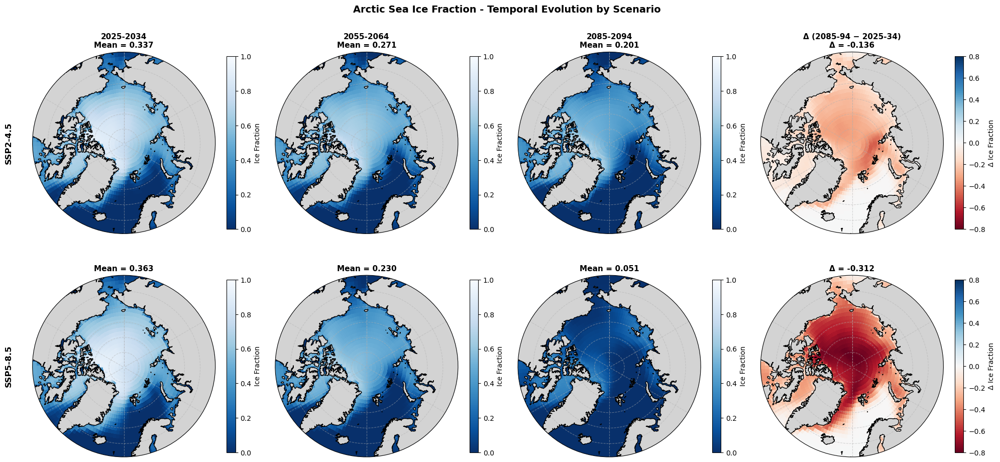

In [ ]:
# ============================================================
# ARCTIC SEA ICE FRACTION (2x4): Rows = scenarios, Cols = decades + temporal difference
# ============================================================

ice_var = 'sicf'

ssp245_ar_25_ice = ssp245_ar_25_34[ice_var].mean(dim='time')
ssp245_ar_55_ice = ssp245_ar_55_64[ice_var].mean(dim='time')
ssp245_ar_85_ice = ssp245_ar_85_94[ice_var].mean(dim='time')

ssp585_ar_25_ice = ssp585_ar_25_34[ice_var].mean(dim='time')
ssp585_ar_55_ice = ssp585_ar_55_64[ice_var].mean(dim='time')
ssp585_ar_85_ice = ssp585_ar_85_94[ice_var].mean(dim='time')

# Temporal differences
diff_ice_245_temporal = ssp245_ar_85_ice - ssp245_ar_25_ice
diff_ice_585_temporal = ssp585_ar_85_ice - ssp585_ar_25_ice

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_ar_ice, axes_ar_ice = plt.subplots(2, 4, figsize=(20, 10),
                                        subplot_kw={'projection': ccrs.NorthPolarStereo()})

arctic_ice_data = [
    [ssp245_ar_25_ice, ssp245_ar_55_ice, ssp245_ar_85_ice, diff_ice_245_temporal],
    [ssp585_ar_25_ice, ssp585_ar_55_ice, ssp585_ar_85_ice, diff_ice_585_temporal],
]
row_labels = ['SSP2-4.5', 'SSP5-8.5']
col_labels = ['2025-2034', '2055-2064', '2085-2094', 'Δ (2085-94 − 2025-34)']

for i, row in enumerate(arctic_ice_data):
    for j, data in enumerate(row):
        ax = axes_ar_ice[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        spatial_mean = float(data.mean())
        
        if j == 3:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu', vmin=-0.8, vmax=0.8)
            cbar_label = 'Δ Ice Fraction'
            mean_text = f'Δ = {spatial_mean:+.3f}'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='Blues_r', vmin=0, vmax=1)
            cbar_label = 'Ice Fraction'
            mean_text = f'Mean = {spatial_mean:.3f}'
        
        ax.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
        ax.coastlines(zorder=3)
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        if j == 0:
            ax.text(-0.15, 0.5, row_labels[i], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_ar_ice.suptitle('Arctic Sea Ice Fraction - Temporal Evolution by Scenario', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_seaice_temporal_evolution.png', dpi=150, bbox_inches='tight')
plt.show()

### Seasonal analysis

In [68]:
# ============================================================
# SEASONAL ANALYSIS - Helper function to select seasons
# ============================================================

def select_season(ds, season):
    """Select data for a specific season.
    SON: September-November
    DJF: December-February
    MAM: March-May
    JJA: June-August
    """
    month = ds['time'].dt.month
    if season == 'SON':
        return ds.sel(time=(month >= 9) & (month <= 11))
    elif season == 'DJF':
        return ds.sel(time=(month == 12) | (month <= 2))
    elif season == 'MAM':
        return ds.sel(time=(month >= 3) & (month <= 5))
    elif season == 'JJA':
        return ds.sel(time=(month >= 6) & (month <= 8))
    else:
        raise ValueError(f"Unknown season: {season}")

seasons = ['SON', 'DJF', 'MAM', 'JJA']
season_names = {'SON': 'Sep-Nov', 'DJF': 'Dec-Feb', 'MAM': 'Mar-May', 'JJA': 'Jun-Aug'}

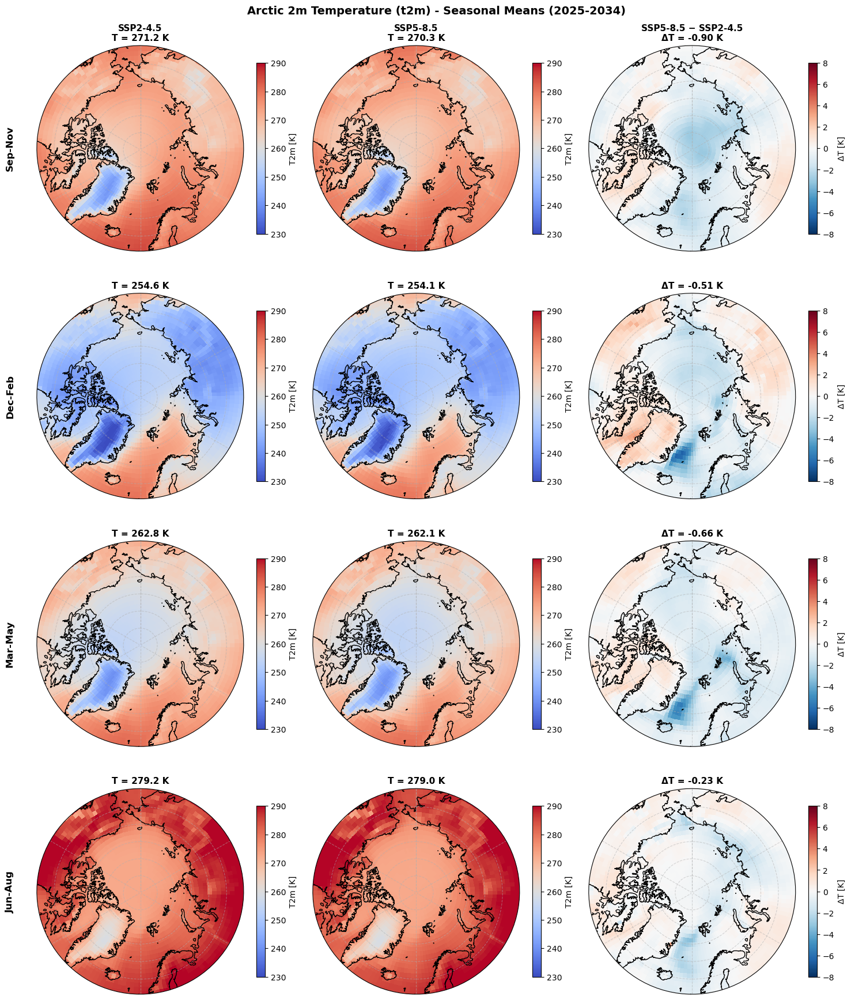

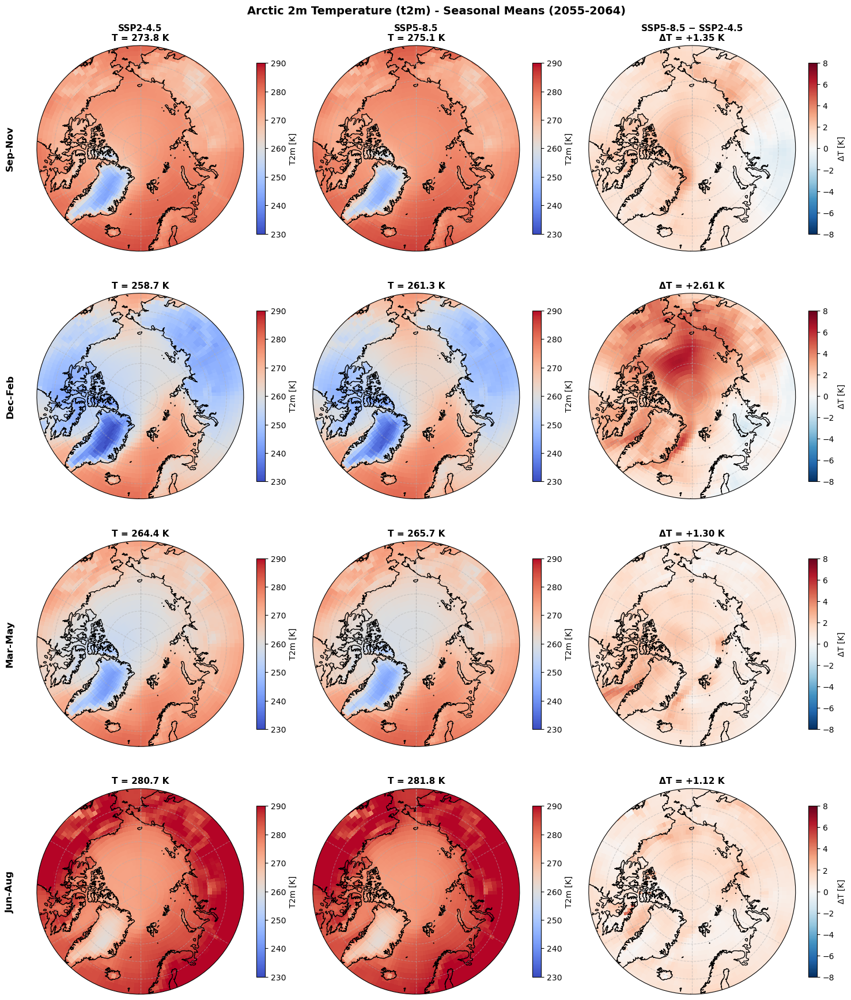

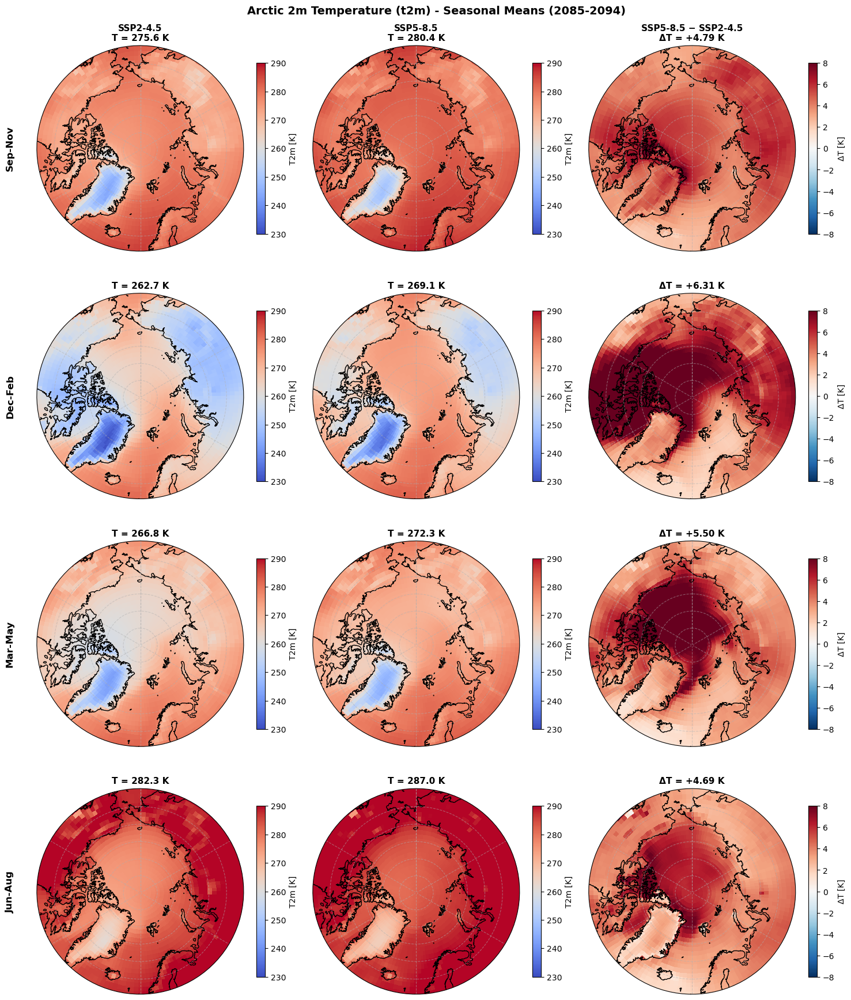

In [ ]:
# ============================================================
# ARCTIC T2M - SEASONAL ANALYSIS (3 separate plots for each decade)
# ============================================================

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

# Datasets for each decade
arctic_datasets = {
    '2025-2034': {'ssp245': ssp245_ar_25_34, 'ssp585': ssp585_ar_25_34},
    '2055-2064': {'ssp245': ssp245_ar_55_64, 'ssp585': ssp585_ar_55_64},
    '2085-2094': {'ssp245': ssp245_ar_85_94, 'ssp585': ssp585_ar_85_94},
}

for decade, datasets in arctic_datasets.items():
    fig_ar, axes_ar = plt.subplots(4, 3, figsize=(15, 18),
                                    subplot_kw={'projection': ccrs.NorthPolarStereo()})
    
    col_labels = ['SSP2-4.5', 'SSP5-8.5', 'SSP5-8.5 − SSP2-4.5']
    
    for i, season in enumerate(seasons):
        # Compute seasonal means
        ssp245_season = select_season(datasets['ssp245']['t2m'], season).mean(dim='time')
        ssp585_season = select_season(datasets['ssp585']['t2m'], season).mean(dim='time')
        diff_season = ssp585_season - ssp245_season
        
        season_data = [ssp245_season, ssp585_season, diff_season]
        
        for j, data in enumerate(season_data):
            ax = axes_ar[i, j]
            ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
            
            # Compute spatial mean for title
            spatial_mean = float(data.mean())
            
            if j == 2:
                c = ax.pcolormesh(data.lon, data.lat, data, 
                                  transform=ccrs.PlateCarree(), 
                                  cmap='RdBu_r', vmin=-8, vmax=8)
                cbar_label = 'ΔT [K]'
                mean_text = f'ΔT = {spatial_mean:+.2f} K'
            else:
                c = ax.pcolormesh(data.lon, data.lat, data, 
                                  transform=ccrs.PlateCarree(), 
                                  cmap='coolwarm', vmin=230, vmax=290)
                cbar_label = 'T2m [K]'
                mean_text = f'T = {spatial_mean:.1f} K'
            
            ax.coastlines()
            ax.gridlines(linestyle='--', alpha=0.5)
            ax.set_boundary(map_circle, transform=ax.transAxes)
            
            plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
            
            # Column label only on first row, mean on all subplots
            if i == 0:
                ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
            else:
                ax.set_title(mean_text, fontsize=11, fontweight='bold')
            
            # Season label on left
            if j == 0:
                ax.text(-0.15, 0.5, season_names[season], transform=ax.transAxes,
                        fontsize=12, fontweight='bold', va='center', rotation=90)
    
    fig_ar.suptitle(f'Arctic 2m Temperature (t2m) - Seasonal Means ({decade})', fontsize=14, fontweight='bold')
    plt.tight_layout()
    #plt.savefig(f'figs_spacial/arctic_t2m_seasonal_{decade.replace("-", "_")}.png', dpi=150, bbox_inches='tight')
    plt.show()

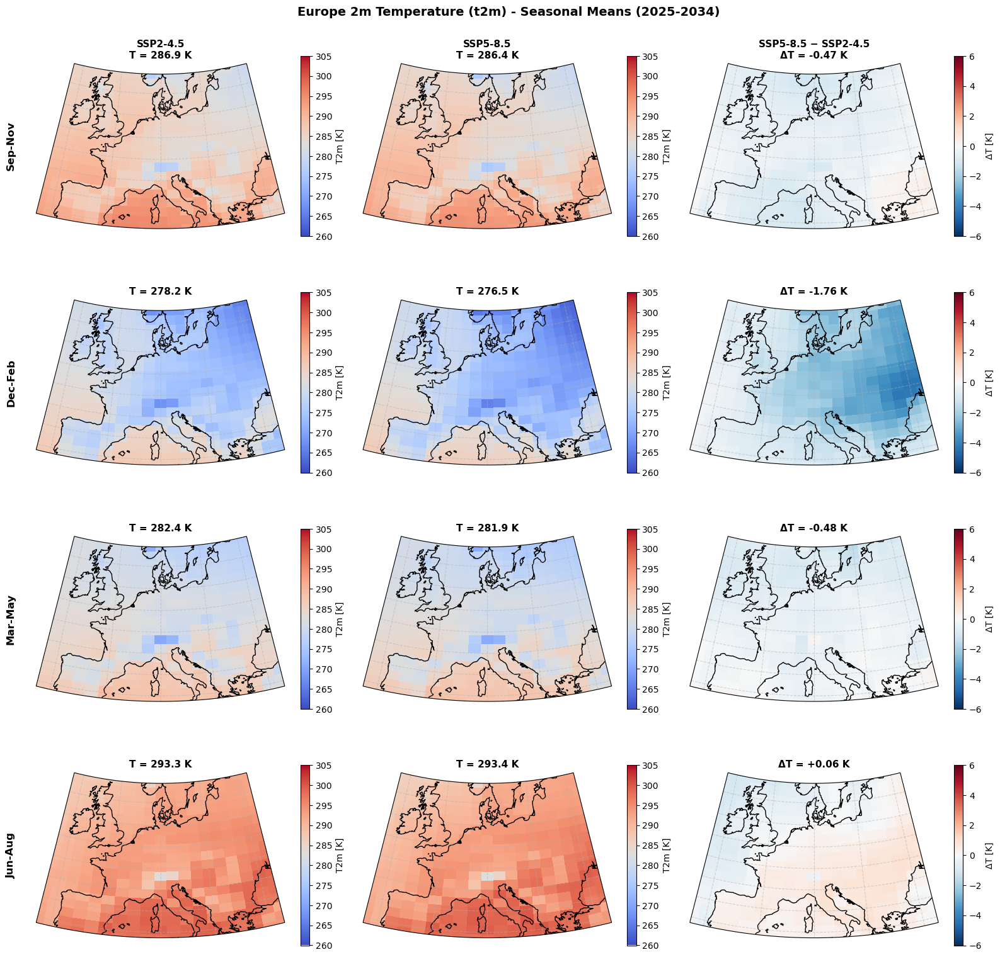

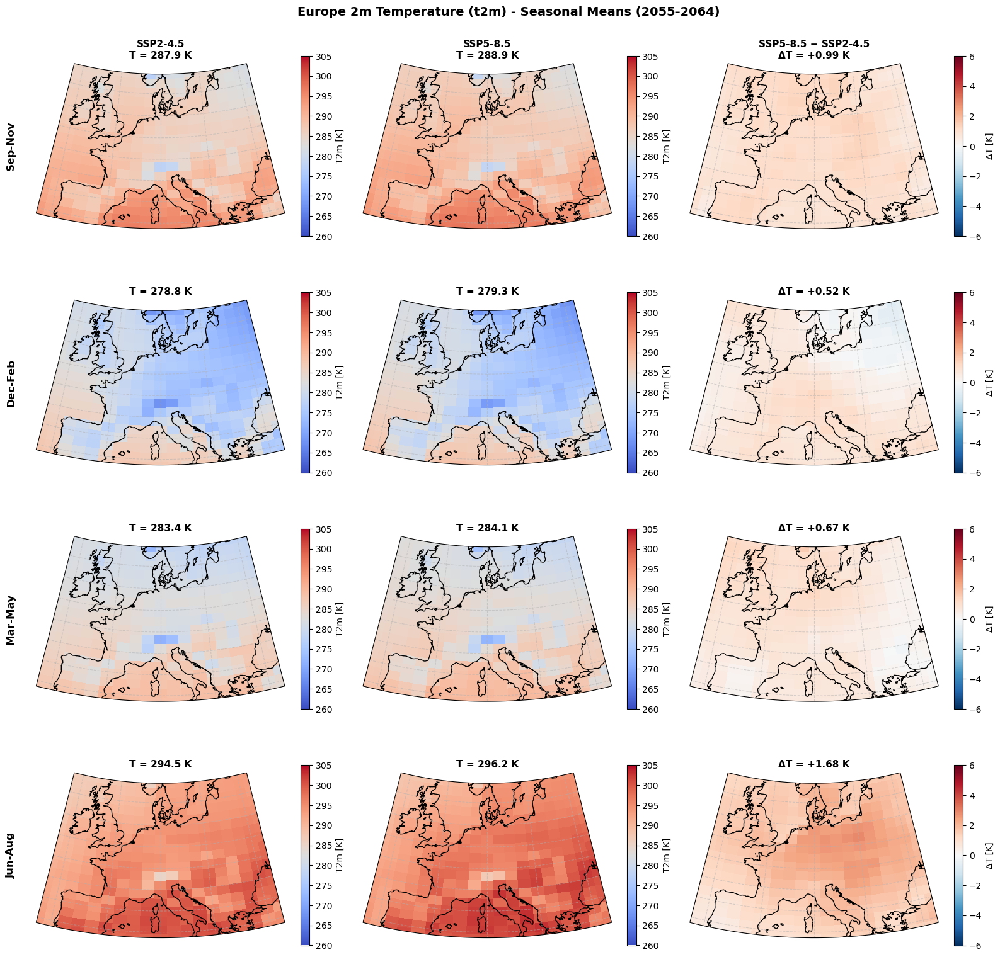

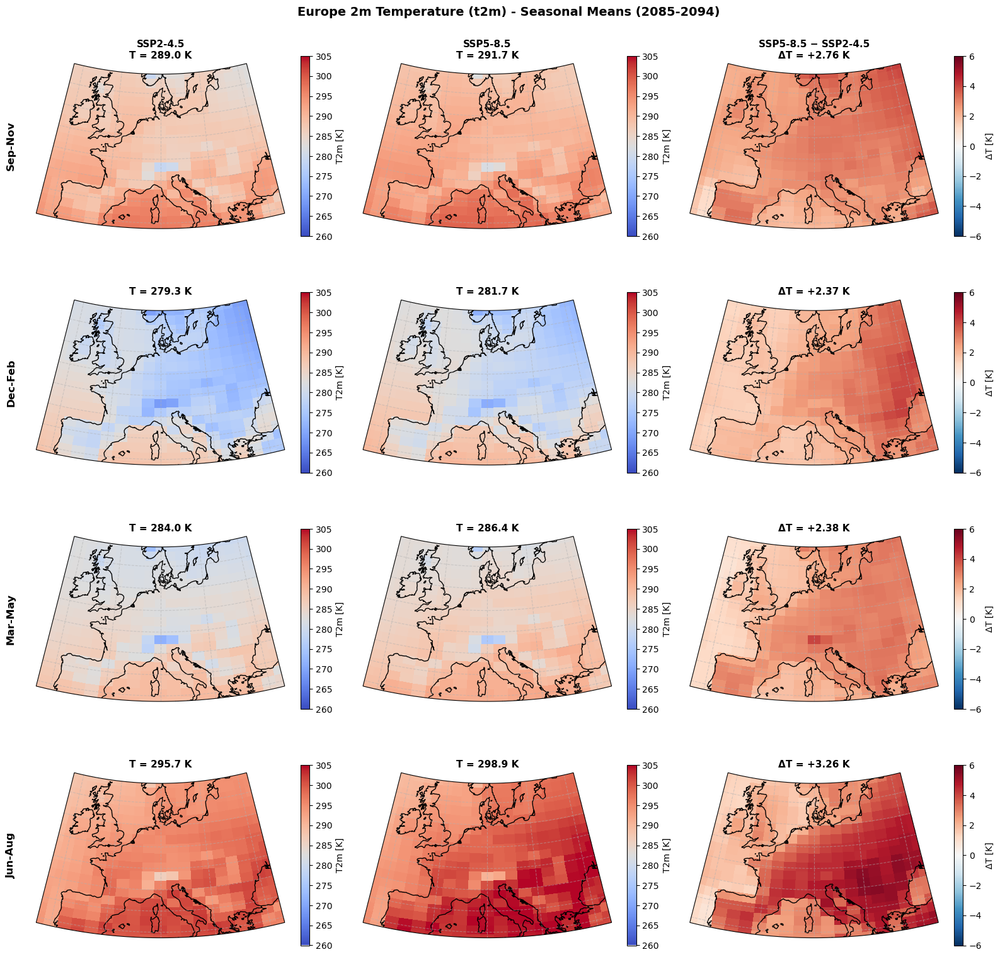

In [ ]:
# ============================================================
# EUROPE T2M - SEASONAL ANALYSIS (3 separate plots for each decade)
# ============================================================

# Get data bounds from first dataset
lon_min = float(ssp245_eu_25_34['t2m'].lon.min())
lon_max = float(ssp245_eu_25_34['t2m'].lon.max())
lat_min = float(ssp245_eu_25_34['t2m'].lat.min())
lat_max = float(ssp245_eu_25_34['t2m'].lat.max())

# Create boundary path
proj = ccrs.LambertConformal(central_longitude=(lon_min+lon_max)/2)
n_points = 50
bottom = np.column_stack([np.linspace(lon_min, lon_max, n_points), np.full(n_points, lat_min)])
right = np.column_stack([np.full(n_points, lon_max), np.linspace(lat_min, lat_max, n_points)])
top = np.column_stack([np.linspace(lon_max, lon_min, n_points), np.full(n_points, lat_max)])
left = np.column_stack([np.full(n_points, lon_min), np.linspace(lat_max, lat_min, n_points)])
boundary_lonlat = np.vstack([bottom, right, top, left])
boundary_proj = proj.transform_points(ccrs.PlateCarree(), boundary_lonlat[:, 0], boundary_lonlat[:, 1])
boundary_proj = boundary_proj[:, :2]
x_min, x_max = boundary_proj[:, 0].min(), boundary_proj[:, 0].max()
y_min, y_max = boundary_proj[:, 1].min(), boundary_proj[:, 1].max()
boundary_norm = np.column_stack([
    (boundary_proj[:, 0] - x_min) / (x_max - x_min),
    (boundary_proj[:, 1] - y_min) / (y_max - y_min)
])
data_boundary = mpath.Path(boundary_norm)

# Datasets for each decade
europe_datasets = {
    '2025-2034': {'ssp245': ssp245_eu_25_34, 'ssp585': ssp585_eu_25_34},
    '2055-2064': {'ssp245': ssp245_eu_55_64, 'ssp585': ssp585_eu_55_64},
    '2085-2094': {'ssp245': ssp245_eu_85_94, 'ssp585': ssp585_eu_85_94},
}

for decade, datasets in europe_datasets.items():
    fig_eu, axes_eu = plt.subplots(4, 3, figsize=(16, 16),
                                    subplot_kw={'projection': proj})
    
    col_labels = ['SSP2-4.5', 'SSP5-8.5', 'SSP5-8.5 − SSP2-4.5']
    
    for i, season in enumerate(seasons):
        # Compute seasonal means
        ssp245_season = select_season(datasets['ssp245']['t2m'], season).mean(dim='time')
        ssp585_season = select_season(datasets['ssp585']['t2m'], season).mean(dim='time')
        diff_season = ssp585_season - ssp245_season
        
        season_data = [ssp245_season, ssp585_season, diff_season]
        
        for j, data in enumerate(season_data):
            ax = axes_eu[i, j]
            ax.set_extent([lon_min, lon_max, lat_min, lat_max], ccrs.PlateCarree())
            ax.set_boundary(data_boundary, transform=ax.transAxes)
            
            # Compute spatial mean for title
            spatial_mean = float(data.mean())
            
            if j == 2:
                c = ax.pcolormesh(data.lon, data.lat, data, 
                                  transform=ccrs.PlateCarree(), 
                                  cmap='RdBu_r', vmin=-6, vmax=6)
                cbar_label = 'ΔT [K]'
                mean_text = f'ΔT = {spatial_mean:+.2f} K'
            else:
                c = ax.pcolormesh(data.lon, data.lat, data, 
                                  transform=ccrs.PlateCarree(), 
                                  cmap='coolwarm', vmin=260, vmax=305)
                cbar_label = 'T2m [K]'
                mean_text = f'T = {spatial_mean:.1f} K'
            
            ax.coastlines()
            ax.gridlines(draw_labels=False, linestyle='--', alpha=0.5)
            
            plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
            
            # Column label only on first row, mean on all subplots
            if i == 0:
                ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
            else:
                ax.set_title(mean_text, fontsize=11, fontweight='bold')
            
            # Season label on left
            if j == 0:
                ax.text(-0.12, 0.5, season_names[season], transform=ax.transAxes,
                        fontsize=12, fontweight='bold', va='center', rotation=90)
    
    fig_eu.suptitle(f'Europe 2m Temperature (t2m) - Seasonal Means ({decade})', fontsize=14, fontweight='bold')
    plt.tight_layout()
    #plt.savefig(f'figs_spacial/europe_t2m_seasonal_{decade.replace("-", "_")}.png', dpi=150, bbox_inches='tight')
    plt.show()

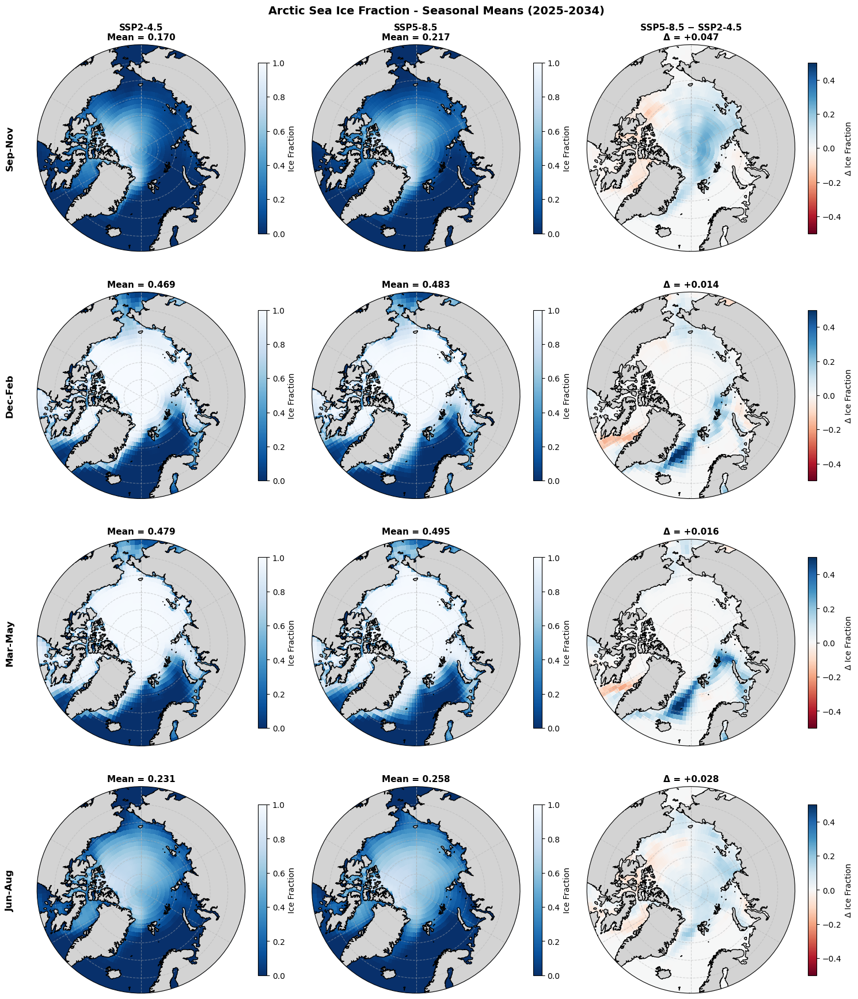

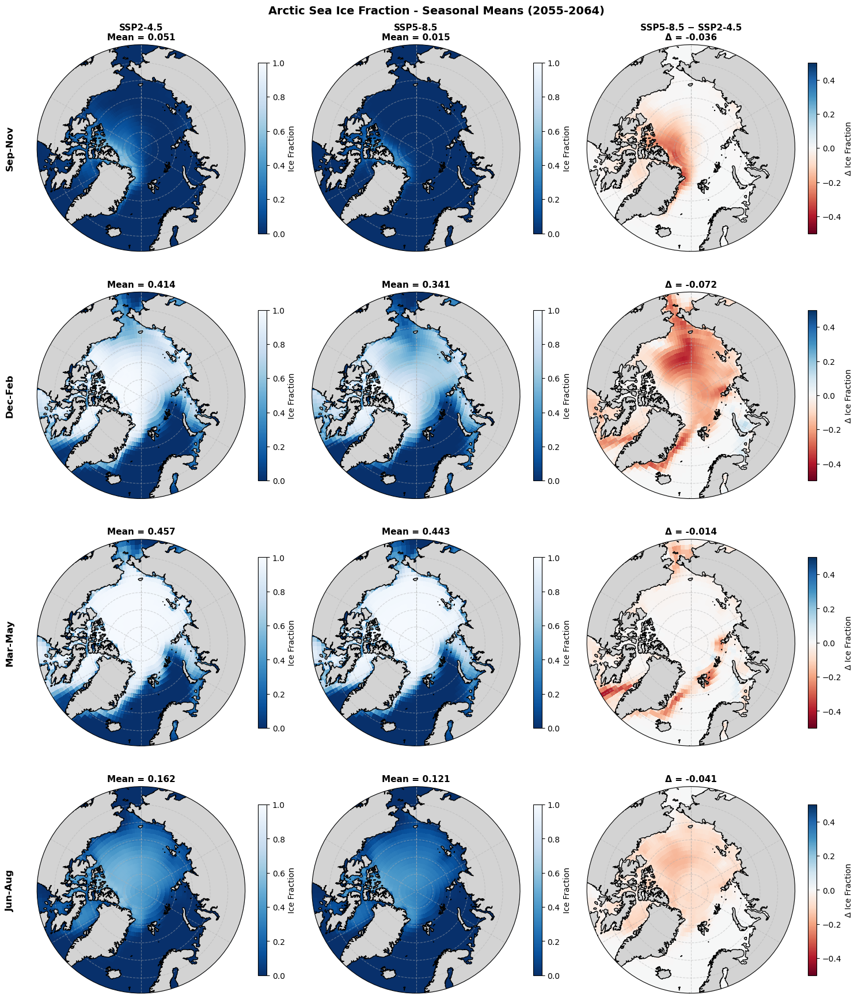

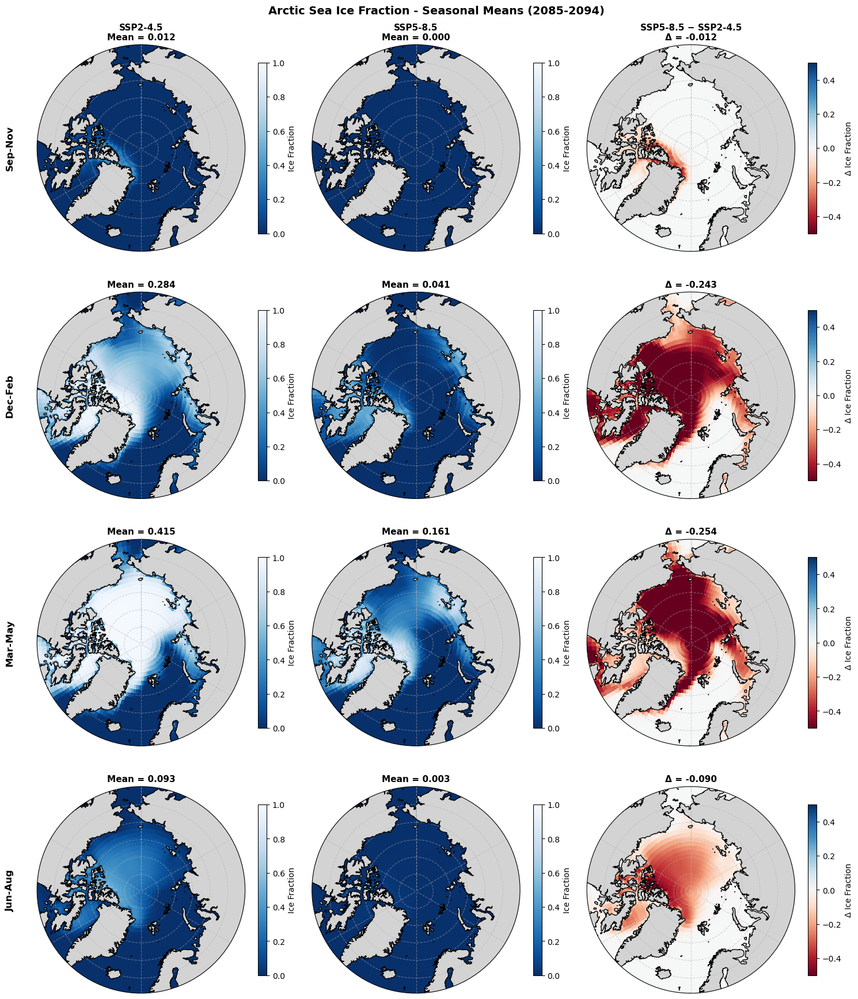

In [ ]:
# ============================================================
# ARCTIC SEA ICE FRACTION - SEASONAL ANALYSIS (3 separate plots for each decade)
# ============================================================

ice_var = 'sicf'

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

# Datasets for each decade
arctic_datasets = {
    '2025-2034': {'ssp245': ssp245_ar_25_34, 'ssp585': ssp585_ar_25_34},
    '2055-2064': {'ssp245': ssp245_ar_55_64, 'ssp585': ssp585_ar_55_64},
    '2085-2094': {'ssp245': ssp245_ar_85_94, 'ssp585': ssp585_ar_85_94},
}

for decade, datasets in arctic_datasets.items():
    fig_ice, axes_ice = plt.subplots(4, 3, figsize=(15, 18),
                                      subplot_kw={'projection': ccrs.NorthPolarStereo()})
    
    col_labels = ['SSP2-4.5', 'SSP5-8.5', 'SSP5-8.5 − SSP2-4.5']
    
    for i, season in enumerate(seasons):
        # Compute seasonal means
        ssp245_season = select_season(datasets['ssp245'][ice_var], season).mean(dim='time')
        ssp585_season = select_season(datasets['ssp585'][ice_var], season).mean(dim='time')
        diff_season = ssp585_season - ssp245_season
        
        season_data = [ssp245_season, ssp585_season, diff_season]
        
        for j, data in enumerate(season_data):
            ax = axes_ice[i, j]
            ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
            
            # Compute spatial mean for title
            spatial_mean = float(data.mean())
            
            if j == 2:
                c = ax.pcolormesh(data.lon, data.lat, data, 
                                  transform=ccrs.PlateCarree(), 
                                  cmap='RdBu', vmin=-0.5, vmax=0.5)
                cbar_label = 'Δ Ice Fraction'
                mean_text = f'Δ = {spatial_mean:+.3f}'
            else:
                c = ax.pcolormesh(data.lon, data.lat, data, 
                                  transform=ccrs.PlateCarree(), 
                                  cmap='Blues_r', vmin=0, vmax=1)
                cbar_label = 'Ice Fraction'
                mean_text = f'Mean = {spatial_mean:.3f}'
            
            ax.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
            ax.coastlines(zorder=3)
            ax.gridlines(linestyle='--', alpha=0.5)
            ax.set_boundary(map_circle, transform=ax.transAxes)
            
            plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
            
            # Column label only on first row, mean on all subplots
            if i == 0:
                ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
            else:
                ax.set_title(mean_text, fontsize=11, fontweight='bold')
            
            # Season label on left
            if j == 0:
                ax.text(-0.15, 0.5, season_names[season], transform=ax.transAxes,
                        fontsize=12, fontweight='bold', va='center', rotation=90)
    
    fig_ice.suptitle(f'Arctic Sea Ice Fraction - Seasonal Means ({decade})', fontsize=14, fontweight='bold')
    plt.tight_layout()
    #plt.savefig(f'figs_spacial/arctic_seaice_seasonal_{decade.replace("-", "_")}.png', dpi=150, bbox_inches='tight')
    plt.show()